In [6]:
from IPython.display import HTML
from tools import toggle_on_off
HTML(toggle_on_off)

In [7]:
import bokeh.plotting as bk
import matplotlib.pyplot as plt


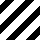
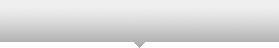
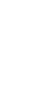
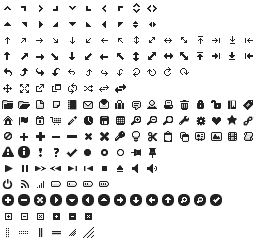
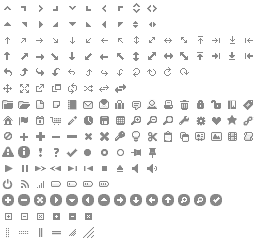
...
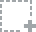
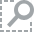
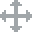
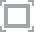
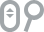

In [9]:
bk.output_notebook(force=True)

In [10]:
import numpy as np

In [11]:
from scipy import optimize
import numpy as np

def f(x):
    return x**2 + 10*np.sin(x)

x = np.arange(-10, 10, 0.1)

fig = bk.figure()
fig.plot_height = 600
fig.plot_width = 600
fig.line(x, f(x))
bk.show(fig)

In [12]:
from __future__ import division

from collections import OrderedDict
import numpy as np
from bokeh.plotting import figure, show
from bokeh.models.glyphs import Text
from bokeh.models import HoverTool, ColumnDataSource

def ima_to_rgba32(ima,alpha=1.,mask=None,invert_order=False,string=False):
    """ convert an image to a 32bit per pixel image
    """
    if ima.ndim == 3:
        m,n,p = ima.shape
        img = np.empty((m,n), dtype=np.uint32)
        view = img.view(dtype=np.uint8).reshape((m, n, 4))
        if invert_order:
            for i in range(m):
                for j in range(n):
                    view[i, j, 2] = ima[i,j,0]
                    view[i, j, 1] = ima[i,j,1]
                    view[i, j, 0] = ima[i,j,2]
                    view[i, j, 3] = 255*alpha
        else:
            for i in range(m):
                for j in range(n):
                    view[i, j, 0] = ima[i,j,0]
                    view[i, j, 1] = ima[i,j,1]
                    view[i, j, 2] = ima[i,j,2]
                    view[i, j, 3] = 255*alpha
    
    if ima.ndim == 2:
        m,n = ima.shape
        img = np.empty((m,n), dtype=np.uint32)
        view = img.view(dtype=np.uint8).reshape((m, n, 4))
        if invert_order:
            for i in range(m):
                for j in range(n):
                    view[i, j, 2] = ima[i,j]
                    view[i, j, 1] = ima[i,j]
                    view[i, j, 0] = ima[i,j]
                    view[i, j, 3] = 255*alpha
        else:
            for i in range(m):
                for j in range(n):
                    view[i, j, 0] = ima[i,j]
                    view[i, j, 1] = ima[i,j]
                    view[i, j, 2] = ima[i,j]
                    view[i, j, 3] = 255*alpha

    if mask is not None:
        view[:,:,3] = mask
    
    if string:
        return ['#%x'%(c & 0x00ffffff) for c in img.flatten()]
    else:         
        return img,m,n

def bk_image(ima,title="",flip=False):
    """ Display a simple image in Bokeh mode
    """
    img,m,n = ima_to_rgba32(ima)
   
    fig = figure(x_range=[0,n], y_range=[0,m],title=title)
    if flip:
        fig.image_rgba(image=[img[-1::-1,:]], x=[0], y=[0], dw=[n], dh=[m])
    else:
        fig.image_rgba(image=[img], x=[0], y=[0], dw=[n], dh=[m])
    show(fig);  # open a browser
    
def bk_image_hoover(ima,show_xy=False,show_value=True):
    """ Display a simple image in Bokeh mode + hoover tool (level + pixel coordinates)
    """
    if ima.ndim == 2:
        m,n = ima.shape[:2]
        x_range = [-1,n]
        y_range = [-1,m]
        value = ima.flatten()
        color = ["#%02x%02x%02x"%(v,v,v) for v in value]
    if ima.ndim == 3:
        m,n,p = ima.shape
        x_range = [-1,n]
        y_range = [-1,m]        
        color = ["#%02x%02x%02x"%(r,g,b) for r,g,b in zip(ima[:,:,0].flatten(),ima[:,:,1].flatten(),ima[:,:,2].flatten())]
        value = ["[%03d,%03d,%03d]"%(r,g,b) for r,g,b in zip(ima[:,:,0].flatten(),ima[:,:,1].flatten(),ima[:,:,2].flatten())]
    
    x,y = np.meshgrid(range(n),range(m))        
    source = ColumnDataSource(
        data=dict(
            value=value,
            x=x.flatten(),
            y=y.flatten(),
            color=color,
            name=['pixel %d' for d in range(10)],        
        )
    )
    TOOLS = "hover,save,wheel_zoom,pan,reset"

    p = figure(title='',tools=TOOLS,x_range=x_range,y_range=y_range,x_axis_type=None, y_axis_type=None)
    p.plot_width = min(50*n,1000)
    p.plot_height = min(50*m,1000)
    p.toolbar_location = "left"

    p.rect("x", "y", 1., 1., source=source, fill_alpha=1.,color="color",line_color=None)
    hover = p.select(dict(type=HoverTool))
    d = OrderedDict([])
    if show_value:
        d["value"] = "@value"
    if show_xy:
        d["x"] = "@x"
        d["y"] = "@y"
    hover.tooltips= d
    show(p)

In [13]:
from skimage import data
import skimage.filter.rank as skr
from skimage.morphology import disk

rgb = data.lena()[-1::-1,:,:]
gima = rgb[:,:,0]

gr = skr.gradient(gima,disk(2))

h,hbin = np.histogram(gima.flatten(),range(256))

m,n,p = rgb.shape
mask = np.zeros((m,n),dtype=np.uint8)
mask[:256,:256] = 255

img1,m,n = ima_to_rgba32(rgb,alpha=.8)
img2,m,n = ima_to_rgba32(gr,mask=mask)

fig = figure(x_range=[0,n], y_range=[0,m])
fig.title = "Lena"

fig.image_rgba(image=[img1], x=[0], y=[0], dw=[n], dh=[m])
fig.image_rgba(image=[img2], x=[0], y=[0], dw=[n], dh=[m])

fig.line(hbin,255.*h/np.max(h),color="#0000FF", alpha=.5)
show(fig);  # open a browser

/home/olivier/anaconda/lib/python2.7/site-packages/skimage/filter/__init__.py:6: skimage_deprecation: The `skimage.filter` module has been renamed to `skimage.filters`.  This placeholder module will be removed in v0.13.
  warn(skimage_deprecation('The `skimage.filter` module has been renamed '


In [14]:
from skimage.data import camera
import skimage.filter.rank as skr
from skimage.morphology import disk

import numpy as np

def test_f(ima,f,radii,title=''):
    s = ima
    mask = np.zeros_like(s)
    mask[:,:s.shape[1]/2] = 255
    
    img0,m,n = ima_to_rgba32(ima)
    fig = figure(x_range=[0,n*2], y_range=[0,m*(len(radii)+1)])
    fig.image_rgba(image=[img0], x=[0], y=[0], dw=[n], dh=[m])
    for i,r in enumerate(radii):
        filt = f(g,disk(r))
    
        img,m,n = ima_to_rgba32(filt,mask=mask)
        fig.image_rgba(image=[img0], x=[0], y=[(i+1)*m], dw=[n], dh=[m])
        fig.image_rgba(image=[img], x=[0], y=[(i+1)*m], dw=[n], dh=[m])
        
        fig.text(x=n, y=m*(i+1), text=" radius: %d"%r, angle=0.0, text_color="#960000")        
        
    fig.title = title
    show(fig);  # open a browser
    
 

In [15]:
g = camera()[-1::-1,:]
f = skr.gradient

test_f(g,f,range(1,3),'gradient')

In [16]:
g = camera()[-1::-1,:]
f = skr.equalize

test_f(g,f,range(10,30,10),'equalize')

In [17]:
bk_image_hoover((disk(3)==0)*255)

In [18]:
rgb32,m,n = ima_to_rgba32(rgb[100:110,100:150,:])

In [19]:
bk_image_hoover(rgb[::30,::30,:])

In [1]:
from tools import ext_image

In [4]:
rgb = ext_image('mandrill')
bk_image(rgb,flip=True)

NameError: name 'bk_image' is not defined

In [3]:
type(rgb)

numpy.ndarray

In [21]:
from skimage.color import rgb2lab

fig = bk.figure()
fig.plot_height = 400
fig.plot_width = 400

sub = rgb[::10,::10,:]
xyz = rgb2lab(sub)
x = xyz[:,:,1].flatten()
z = xyz[:,:,2].flatten()
color = ima_to_rgba32(sub,invert_order=True,string=True)

fig.scatter(x, z, marker='o',
            line_color=None, fill_color=color, 
            fill_alpha=.5, size=12)

bk.show(fig)

